# <center>Petrol Price Prediction

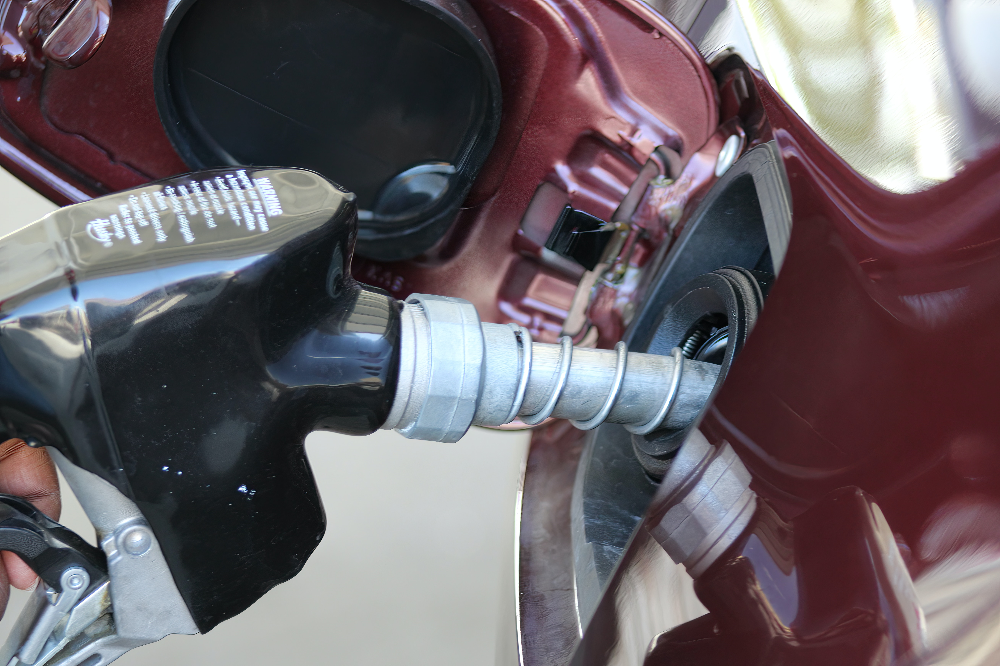

The "Petrol Price in India" dataset available on Kaggle contains information about the prices of petrol, a type of fuel, in India over time. The dataset includes several fields, including "month-year", which provides the date of the petrol price; "opening", which represents the price of petrol at the beginning of the day; "closing", which represents the price of petrol at the end of the day; "highest", which represents the highest price of petrol reached during the day; and "lowest", which represents the lowest price of petrol reached during the day.

The dataset provides a valuable resource for anyone interested in analyzing petrol prices in India over time. For instance, researchers may use this dataset to identify trends in petrol prices, explore the impact of various factors such as global crude oil prices and government policies on petrol prices, or even develop predictive models to forecast future petrol prices in India.

### Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score,mean_absolute_error, mean_squared_error
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.linear_model import LinearRegression,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor,AdaBoostRegressor
from sklearn.svm import LinearSVR

In [2]:
df=pd.read_csv('./PetrolPriceIndia.csv')
df

,Month-Year,Opening,Closing,Lowest,Highest
0,Jan-18,72.53,75.630,72.53,75.630
1,Feb-18,75.77,74.150,74.14,76.120
2,Mar-18,74.21,76.290,74.21,76.290
3,Apr-18,76.48,77.430,76.48,77.470
4,May-18,77.43,81.390,77.43,81.470
5,Jun-18,81.32,78.400,78.40,81.320
6,Jul-18,78.40,79.310,78.40,79.800
7,Aug-18,79.26,81.630,79.26,81.630
8,Sep-18,81.81,86.800,81.81,86.800
9,Oct-18,87.13,82.700,82.70,87.390


### Exploratory Data Analysis

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36 entries, 0 to 35
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Month-Year  36 non-null     object 
 1   Opening     36 non-null     float64
 2   Closing     36 non-null     float64
 3   Lowest      36 non-null     float64
 4   Highest     36 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.5+ KB


In [4]:
df.shape

(36, 5)

In [5]:
df.describe()

,Opening,Closing,Lowest,Highest
count,36.000000,36.000000,36.000000,36.000000
mean,77.708056,78.085917,76.722778,79.063139
std,4.348952,4.460064,4.268725,4.305838
min,71.380000,71.380000,71.050000,72.370000
25%,74.690000,74.737500,73.562500,75.747500
50%,75.950000,76.220000,75.565000,77.515000
75%,81.442500,81.897500,78.615000,82.790000
max,87.130000,86.800000,85.310000,87.390000


In [6]:
df.isnull().mean()*100

Month-Year    0.0
Opening       0.0
Closing       0.0
Lowest        0.0
Highest       0.0
dtype: float64

### Visualization

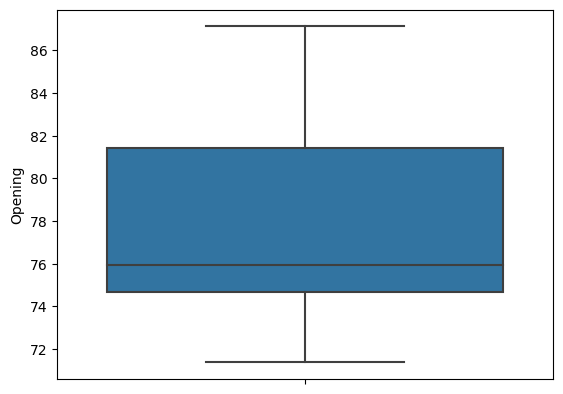

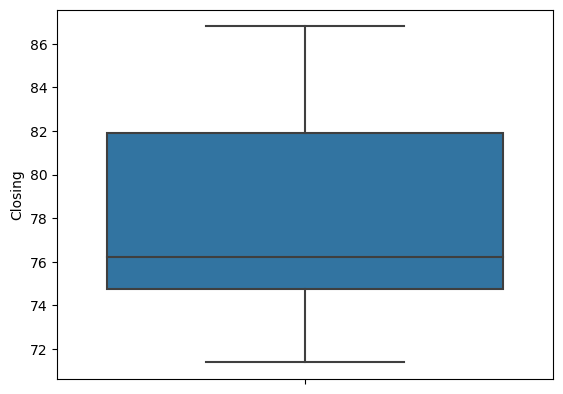

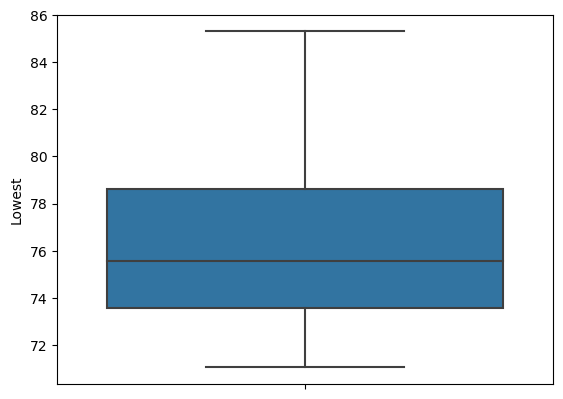

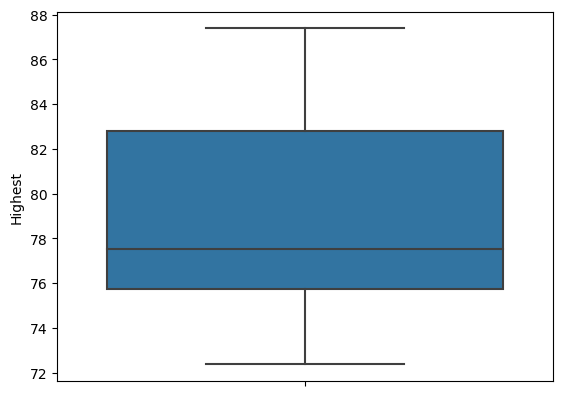

In [7]:
for i in df.columns:
    if df[i].dtype != 'object':
        sns.boxplot(y=df[i])
        plt.show()

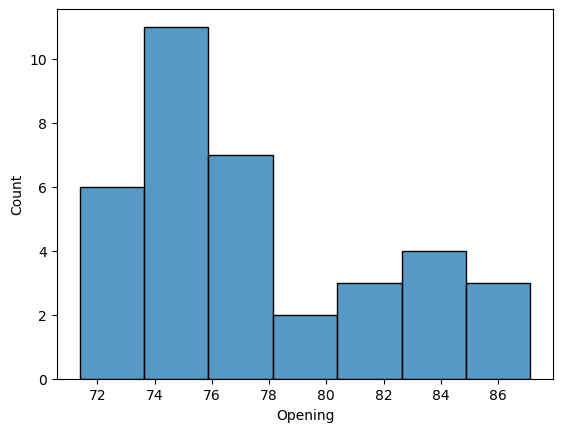

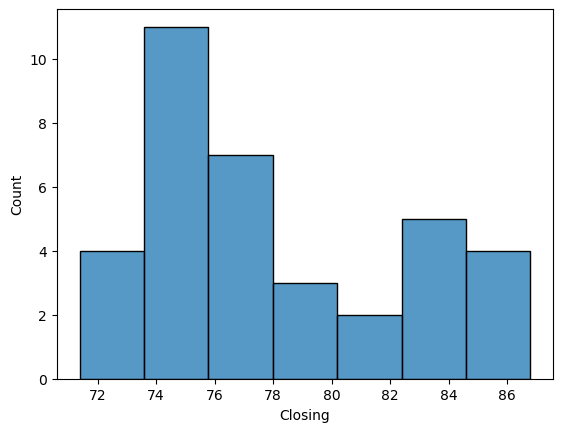

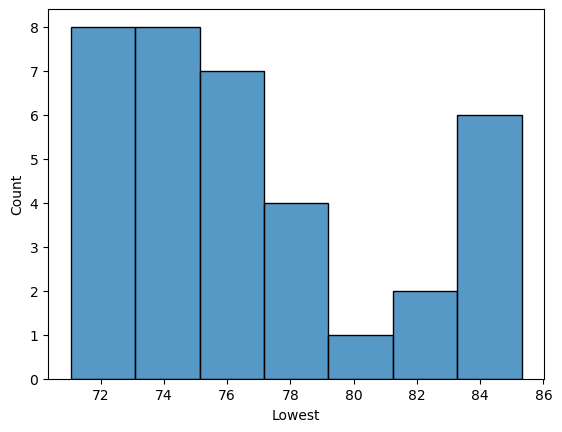

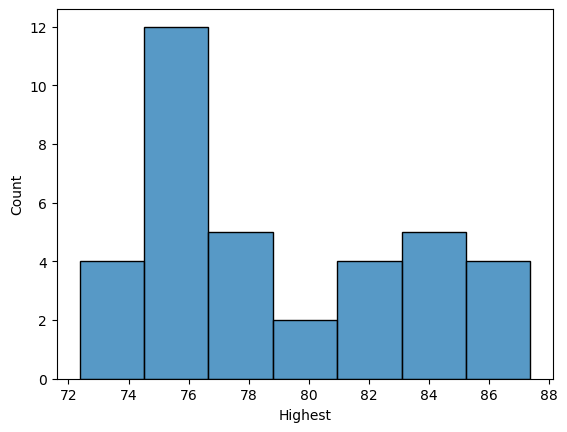

In [8]:
for i in df.columns:
    if df[i].dtype != 'object':
        sns.histplot(x=df[i])
        plt.show()

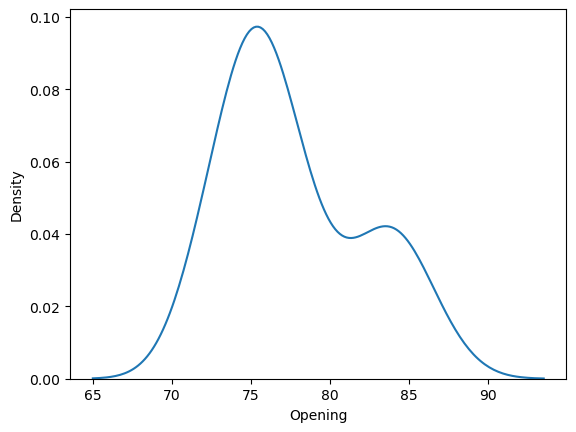

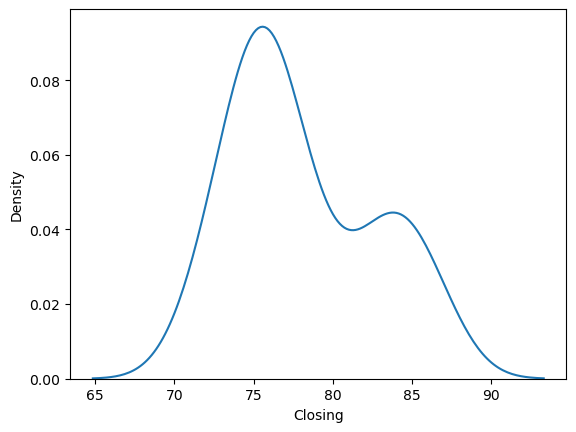

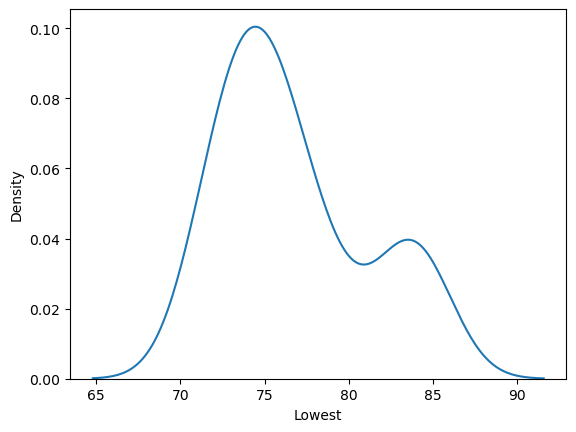

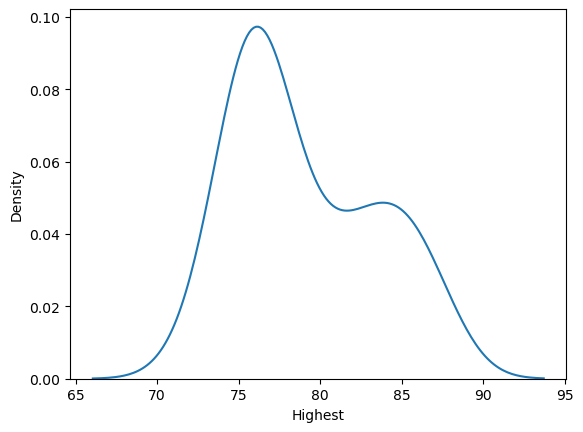

In [9]:
for i in df.columns:
    if df[i].dtype != 'object':
        sns.kdeplot(x=df[i])
        plt.show()

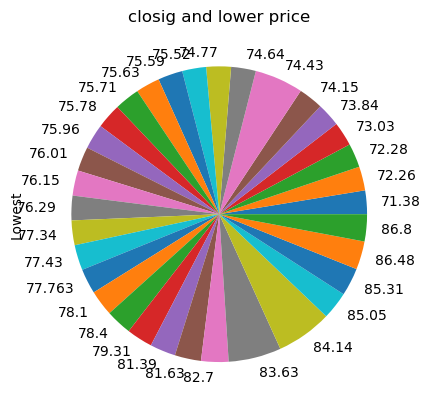

In [10]:
low_close=df.groupby(['Closing'])['Lowest'].sum()
low_close.plot.pie().set(title='closig and lower price');

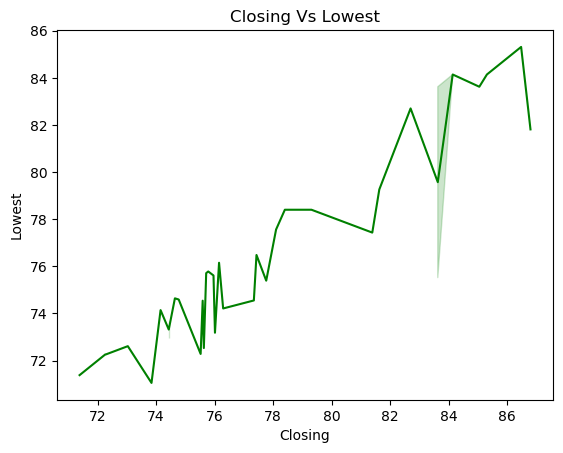

In [11]:
plt.title('Closing Vs Lowest')
sns.lineplot('Closing','Lowest',data=df,color='Green')
plt.show()

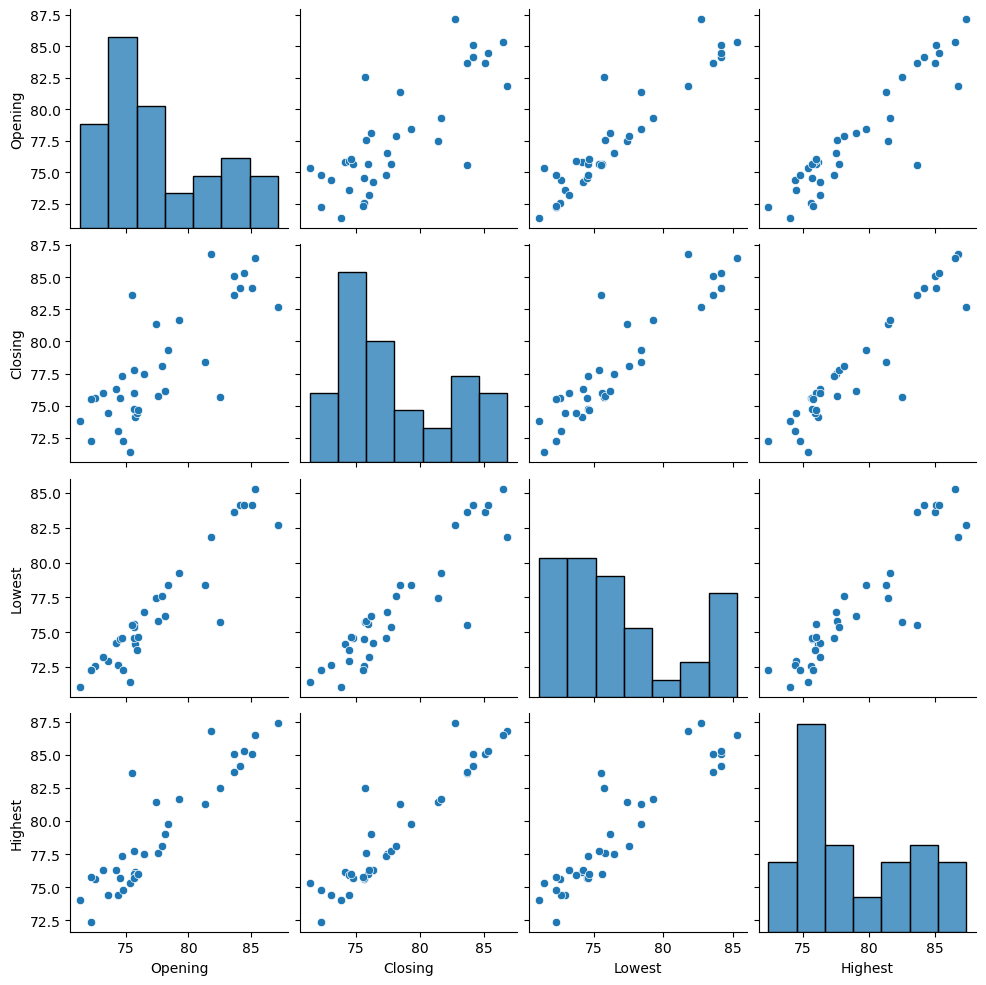

In [12]:
sns.pairplot(df)

#### Find and Remove Outlier

In [13]:
def outlier_limit(col):
    Q3,Q1=np.nanpercentile(col,[75,25])
    IQR=Q3-Q1
    UL=Q3+1.5*IQR
    LL=Q1-1.5*Q1
    return UL,LL

In [14]:
for column in df.columns:
    if df[column].dtype != 'object':
        UL,LL = outlier_limit(df[column])
        df[column]=np.where((df[column]>UL) | (df[column]<LL),np.nan,df[column])

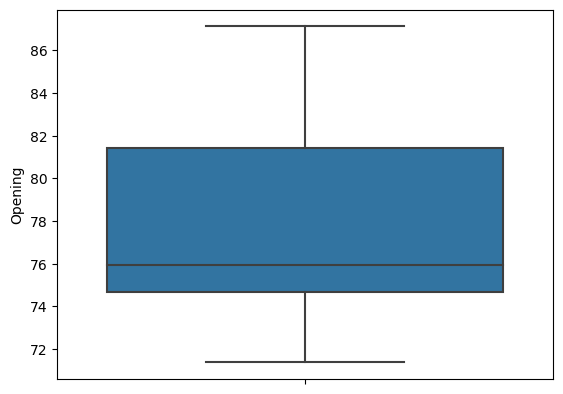

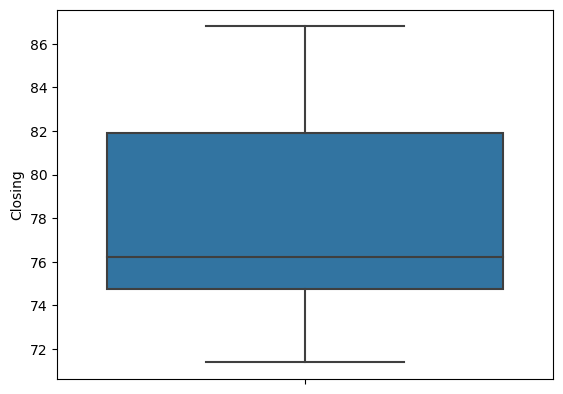

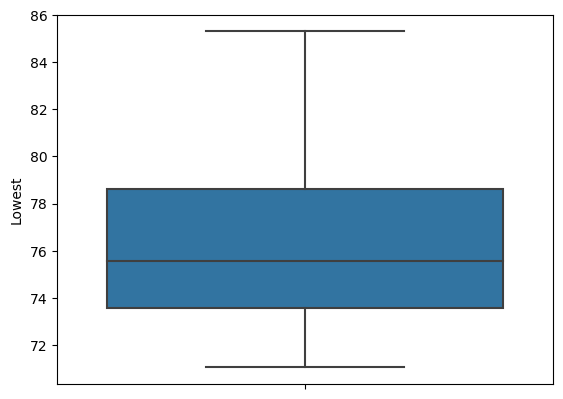

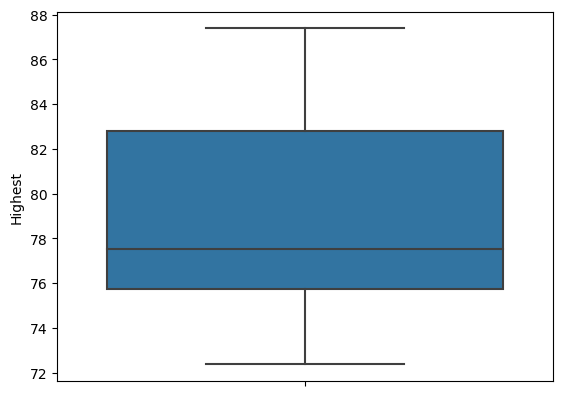

In [15]:
for i in df.columns:
    if df[i].dtype != 'object':
        sns.boxplot(y=df[i])
        plt.show()

#### After the outlier treatment again drop the null values

In [16]:
df.dropna(inplace=True)

#### Label Encoding

In [17]:
le = LabelEncoder()
df['Month-Year'] = le.fit_transform(df['Month-Year'])

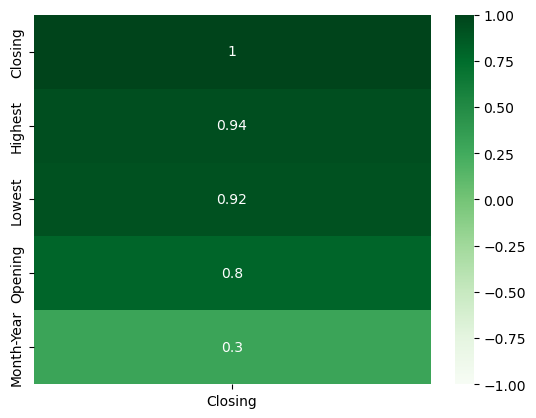

In [18]:
sns.heatmap(df.corr()[["Closing"]].sort_values(by="Closing", ascending=False), vmin=-1, vmax=1, annot=True,cmap="Greens");

In [19]:
x= df[['Month-Year', 'Opening','Lowest', 'Highest']].values
y = df[['Closing']].values

In [20]:
sc = StandardScaler()
x = sc.fit_transform(x)

#### Finding the best model using Cross validation

In [21]:
models = {
    "LinearRegression": LinearRegression(),
    "Ridge":Ridge(),
    "LinearSVR":LinearSVR(),
    "DecisionTreeRegressor":DecisionTreeRegressor(),
    "GradientBoostingRegressor":GradientBoostingRegressor(),
    "AdaBoostRegressor":AdaBoostRegressor(),
    "RandomForestRegressor":RandomForestRegressor()
}

In [22]:
for name, model in models.items():
    scores = cross_val_score(model, x,y, scoring="neg_mean_squared_error",cv=10,n_jobs=-1)
    print("cross validation model : {}".format(name))
    rmse = np.sqrt(-scores)
    rmse_average = np.mean(rmse)
    print("AVERAGE RMSE: ",rmse_average)
    print("*"*100)

cross validation model : LinearRegression
AVERAGE RMSE:  0.27585265109471246
****************************************************************************************************
cross validation model : Ridge
AVERAGE RMSE:  0.747782849969369
****************************************************************************************************
cross validation model : LinearSVR
AVERAGE RMSE:  55.375008115385015
****************************************************************************************************
cross validation model : DecisionTreeRegressor
AVERAGE RMSE:  1.8880571254906904
****************************************************************************************************
cross validation model : GradientBoostingRegressor
AVERAGE RMSE:  1.8312748088231694
****************************************************************************************************
cross validation model : AdaBoostRegressor
AVERAGE RMSE:  1.9423765586447856
******************************************

#### Splitting the data into training and testing

In [23]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=0)

In [24]:
model = LinearRegression()
model.fit(x_train, y_train)
LinearRegression()
y_pred = model.predict(x)
result = pd.DataFrame(zip(y,y_pred), columns=("ACTUAL", "PREDICTION"),dtype=float)
result.head()

,ACTUAL,PREDICTION
0,75.63,75.615634
1,74.15,74.464772
2,76.29,76.306937
3,77.43,77.480596
4,81.39,81.402819


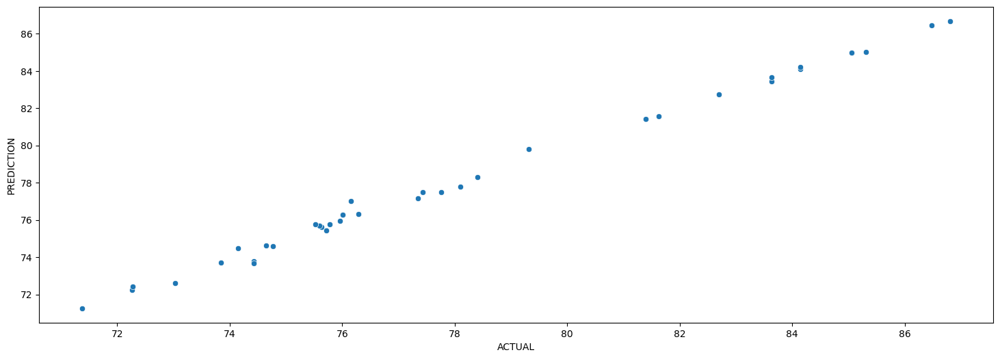

In [25]:
plt.figure(figsize=(18,6))
sns.scatterplot(x='ACTUAL', y='PREDICTION', data=result);

In [26]:
model.score(x,y)

0.9958127782430793